In [ ]:
name = "Hao Yuan"
cuid = "hy2814"

# Environment and Preparation

In [ ]:
!pip install gym[classic_control]

In [ ]:
import gym
import math
import random
import numpy as np
import torch
import torch.nn as nn
import torch.optim as optim
from collections import deque
import matplotlib.pyplot as plt
import matplotlib.animation
from IPython.display import HTML

print("Gym version:", gym.__version__)

Gym version: 0.25.2


In [ ]:
seed = 6885
random.seed(seed)
np.random.seed(seed)
torch.manual_seed(seed)

if torch.cuda.is_available():
    torch.cuda.manual_seed(seed)
    torch.backends.cudnn.deterministic = True
    torch.backends.cudnn.benchmark = False

In [ ]:
def average_episodic_return(env, agent, episodes=10, max_steps_per_episode=1000):
    epoch_rewards = []
    for episode in range(episodes):
        total_rewards = 0
        obs = env.reset()
        for t in range(max_steps_per_episode):
            out = agent(obs)
            assert ("Action" in out), "The key 'Action' was missing from the agents output."
            obs, rew, done, _, _ = env.step(out["Action"])
            total_rewards += rew
            if done:
                break

        epoch_rewards.append(total_rewards)

    return {
        "AverageEpisodicReturn": np.mean(epoch_rewards),
        "StandardDeviation":np.sqrt(np.var(epoch_rewards))
    }

In [ ]:
%matplotlib inline
def animate_agent(env, agent, max_steps = 500):
    obs = env.reset()
    frames = deque()
    frames.append(env.render(mode='rgb_array'))
    for _ in range(max_steps):
        out = agent(obs)
        assert ("Action" in out), "The key 'Action' was missing from the agents output."
        action = out["Action"]
        obs, _ , done, _ , _ = env.step(action)
        frames.append(env.render(mode='rgb_array'))
        if done:
            break

    return animate_frames(frames)

def animate_frames(frames):
    new_height = 2.2
    original_height = frames[0].shape[0]
    original_width = frames[0].shape[1]
    new_width = (new_height / original_height) * original_width
    fig = plt.figure(figsize=(new_width, new_height), dpi = 120)

    ax = plt.Axes(fig, [0., 0., 1., 1.])
    ax.set_axis_off()
    fig.add_axes(ax)
    patch = ax.imshow(frames[0], aspect='auto', animated=True, interpolation='bilinear')
    animate = lambda i: patch.set_data(frames[i])

    ani = matplotlib.animation.FuncAnimation(fig, animate, frames=len(frames), interval = 50)

    plt.close()
    return HTML(ani.to_jshtml())

In [ ]:
class QNetwork(nn.Module):
    def __init__(self, state_dim, action_dim, hidden_layers):
        super(QNetwork, self).__init__()

        layers = []
        input_dim = state_dim

        for hidden_dim in hidden_layers:
            layers.append(nn.Linear(input_dim, hidden_dim))
            nn.init.kaiming_uniform_(layers[-1].weight, nonlinearity='relu')
            layers.append(nn.ReLU())
            input_dim = hidden_dim

        layers.append(nn.Linear(input_dim, action_dim))
        nn.init.xavier_uniform_(layers[-1].weight)

        self.model = nn.Sequential(*layers)

    def forward(self, x):
        return self.model(x)


In [ ]:
class ReplayBuffer:
    def __init__(self, capacity, device, state_mean=None, state_std=None):
        self.capacity = capacity
        self.buffer = deque(maxlen=capacity)
        self.device = device
        self.state_mean = state_mean
        self.state_std = state_std

    def push(self, state, action, reward, next_state, done):
        self.buffer.append((state, action, reward, next_state, done))

    def sample(self, batch_size):
        batch = random.sample(self.buffer, batch_size)
        states, actions, rewards, next_states, dones = zip(*batch)
        return states, actions, rewards, next_states, dones


    def __len__(self):
        return len(self.buffer)

In [ ]:
class Agent():
    def __init__(self, env, hidden_layers, buffer_size, optimizer, lr, loss_fn, batch_size = 64, gamma = 0.99):
        self.device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
        self.env = env
        self.action_dim = env.action_space.n
        self.state_dim = env.observation_space.shape[0]
        self.policy_net = QNetwork(self.state_dim, self.action_dim, hidden_layers).to(self.device)
        self.target_net = QNetwork(self.state_dim, self.action_dim, hidden_layers).to(self.device)
        self.update_target_network()
        self.buffer = ReplayBuffer(buffer_size, self.device)
        self.optimizer = optimizer(self.policy_net.parameters(), lr=lr)
        self.loss_fn = loss_fn()
        self.batch_size = batch_size
        self.gamma = gamma
        self.max_steps = env.spec.max_episode_steps

    def train(self, num_episodes, epsilon_decay, update_target_every_steps=1000,
              epsilon_start=1.0, epsilon_end=0.01, tau=0.0, USE_DOUBLE_DQN=False,
              shape_reward=None, verbose=True):

        steps_done = 0
        all_rewards = []

        for episode in range(num_episodes):
            state = self.env.reset()
            episode_reward = 0

            for t in range(self.max_steps):
                epsilon = epsilon_end + (epsilon_start - epsilon_end) * np.exp(-1. * steps_done / epsilon_decay)
                epsilon = max(epsilon, epsilon_end)
                steps_done += 1
                action = self.select_action(state, epsilon)

                next_state, reward, done, truncated, info = self.env.step(action)

                if shape_reward is not None:
                    reward = shape_reward(reward, state, next_state, action, done, info)

                self.buffer.push(state, action, reward, next_state, done)

                state = next_state
                episode_reward += reward

                if len(self.buffer) > self.batch_size:
                    states, actions, rewards, next_states, dones = self.buffer.sample(self.batch_size)
                    states_t = torch.tensor(states, dtype=torch.float32, device=self.device)
                    actions_t = torch.tensor(actions, dtype=torch.long, device=self.device).unsqueeze(-1)
                    rewards_t = torch.tensor(rewards, dtype=torch.float32, device=self.device).unsqueeze(-1)
                    next_states_t = torch.tensor(next_states, dtype=torch.float32, device=self.device)
                    dones_t = torch.tensor(dones, dtype=torch.float32, device=self.device).unsqueeze(-1)

                    q_values = self.policy_net(states_t).gather(1, actions_t)

                    with torch.no_grad():
                        if USE_DOUBLE_DQN:
                            next_actions = self.policy_net(next_states_t).argmax(dim=1, keepdim=True)
                            max_next_q = self.target_net(next_states_t).gather(1, next_actions)
                        else:
                            max_next_q = self.target_net(next_states_t).max(dim=1, keepdim=True)[0]
                        q_target = rewards_t + self.gamma * max_next_q * (1 - dones_t)

                    loss = self.loss_fn(q_values, q_target)
                    self.optimizer.zero_grad()
                    loss.backward()
                    torch.nn.utils.clip_grad_norm_(self.policy_net.parameters(), max_norm=1.0)
                    self.optimizer.step()

                    if tau > 0:
                        for target_param, param in zip(self.target_net.parameters(), self.policy_net.parameters()):
                            target_param.data.copy_(tau * param.data + (1.0 - tau) * target_param.data)
                    elif steps_done % update_target_every_steps == 0:
                        self.update_target_network()

                if done or truncated:
                    break

            all_rewards.append(episode_reward)

            if (episode + 1) % 50 == 0:
                avg_reward = np.mean(all_rewards[-50:])
                if verbose:
                    print(f"Episode: {episode+1}, Avg Reward (last 50 eps): {avg_reward:.2f}, Epsilon: {epsilon:.2f}")

        return all_rewards


    def update_target_network(self):
        self.target_net.load_state_dict(self.policy_net.state_dict())

    def select_action(self, state, epsilon):
        if random.random() < epsilon:
            return random.randint(0, self.action_dim - 1)
        else:
            if not isinstance(state, torch.Tensor):
                state = torch.tensor(state, dtype=torch.float32, device=self.device).unsqueeze(0)
            with torch.no_grad():
                return self.policy_net(state).argmax(dim=1).item()

    def compute_state_statistics(env, num_samples=10000):
        states = []
        state = env.reset()
        for _ in range(num_samples):
            action = env.action_space.sample()  # Random action
            next_state, reward, done, truncated, info = env.step(action)
            states.append(state)
            state = next_state
            if done or truncated:
                state = env.reset()
        states = np.array(states)
        state_mean = np.mean(states, axis=0)
        state_std = np.std(states, axis=0) + 1e-8  # Avoid division by zero
        return state_mean, state_std

    def predict(self, observation):
        with torch.no_grad():
          state_t = torch.tensor([observation], dtype=torch.float32, device=self.device)
          q_values = self.policy_net(state_t)
        return {"Action":q_values.argmax(dim=1).item()}

    def __call__(self,observation):
        return self.predict(observation)


# Pure DQN

## Cartpole Task

In [ ]:
env_cartpole = gym.make('CartPole-v1', new_step_api=True) #return one param instead of two
env_cartpole.reset(seed=6885)

array([ 0.02149944,  0.01634213, -0.03630548,  0.02160819], dtype=float32)

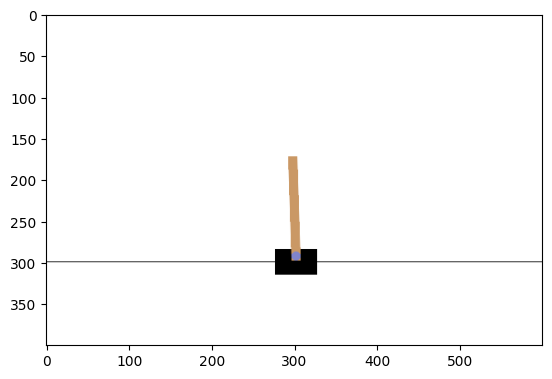

In [ ]:
import matplotlib.pyplot as plt
# make sure the render works
plt.imshow(env_cartpole.render(mode='rgb_array'));

In [ ]:
def agent_left(observation):
    return {"Action":0}
def agent_right(observation):
    return {"Action":1}
def agent_random(observation):
    return {"Action":np.random.choice([0, 1])}

In [ ]:
average_episodic_return(env_cartpole, agent_random)

{'AverageEpisodicReturn': 21.0, 'StandardDeviation': 8.933084573650918}

In [ ]:
animate_agent(env_cartpole, agent_random)

/usr/local/lib/python3.10/dist-packages/gym/core.py:43: DeprecationWarning: WARN: The argument mode in render method is deprecated; use render_mode during environment initialization instead.
See here for more information: https://www.gymlibrary.ml/content/api/
  deprecation(


In [ ]:
hidden_layers = [64,64]
lr = 1e-3
cartpole_agent = Agent(env_cartpole, hidden_layers, 50000, optim.RMSprop, lr, nn.SmoothL1Loss)
epsilon_decay = 500
num_episodes = 500
all_rewards = cartpole_agent.train(num_episodes, epsilon_decay)

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


Episode: 50, Avg Reward (last 50 eps): 12.44, Epsilon: 0.01
Episode: 100, Avg Reward (last 50 eps): 32.94, Epsilon: 0.01
Episode: 150, Avg Reward (last 50 eps): 159.50, Epsilon: 0.01
Episode: 200, Avg Reward (last 50 eps): 222.98, Epsilon: 0.01
Episode: 250, Avg Reward (last 50 eps): 141.16, Epsilon: 0.01
Episode: 300, Avg Reward (last 50 eps): 183.12, Epsilon: 0.01
Episode: 350, Avg Reward (last 50 eps): 177.00, Epsilon: 0.01
Episode: 400, Avg Reward (last 50 eps): 381.42, Epsilon: 0.01
Episode: 450, Avg Reward (last 50 eps): 410.76, Epsilon: 0.01
Episode: 500, Avg Reward (last 50 eps): 479.44, Epsilon: 0.01


In [ ]:
hidden_layers = [64,64]
lr = 5e-4
cartpole_agent = Agent(env_cartpole, hidden_layers, 10000, optim.Adam, lr, nn.SmoothL1Loss)
epsilon_decay = 5000
num_episodes = 1000
all_rewards = cartpole_agent.train(num_episodes, epsilon_decay)

Episode: 50, Avg Reward (last 50 eps): 18.16, Epsilon: 0.84
Episode: 100, Avg Reward (last 50 eps): 18.50, Epsilon: 0.70
Episode: 150, Avg Reward (last 50 eps): 15.08, Epsilon: 0.60
Episode: 200, Avg Reward (last 50 eps): 14.84, Epsilon: 0.52
Episode: 250, Avg Reward (last 50 eps): 16.16, Epsilon: 0.44
Episode: 300, Avg Reward (last 50 eps): 55.56, Epsilon: 0.26
Episode: 350, Avg Reward (last 50 eps): 134.14, Epsilon: 0.07
Episode: 400, Avg Reward (last 50 eps): 131.52, Epsilon: 0.03
Episode: 450, Avg Reward (last 50 eps): 147.64, Epsilon: 0.01
Episode: 500, Avg Reward (last 50 eps): 249.62, Epsilon: 0.01
Episode: 550, Avg Reward (last 50 eps): 168.78, Epsilon: 0.01
Episode: 600, Avg Reward (last 50 eps): 163.34, Epsilon: 0.01
Episode: 650, Avg Reward (last 50 eps): 87.96, Epsilon: 0.01
Episode: 700, Avg Reward (last 50 eps): 101.20, Epsilon: 0.01
Episode: 750, Avg Reward (last 50 eps): 241.84, Epsilon: 0.01
Episode: 800, Avg Reward (last 50 eps): 259.06, Epsilon: 0.01
Episode: 850, Av

In [ ]:
average_episodic_return(env_cartpole, cartpole_agent)

{'AverageEpisodicReturn': 1000.0, 'StandardDeviation': 0.0}

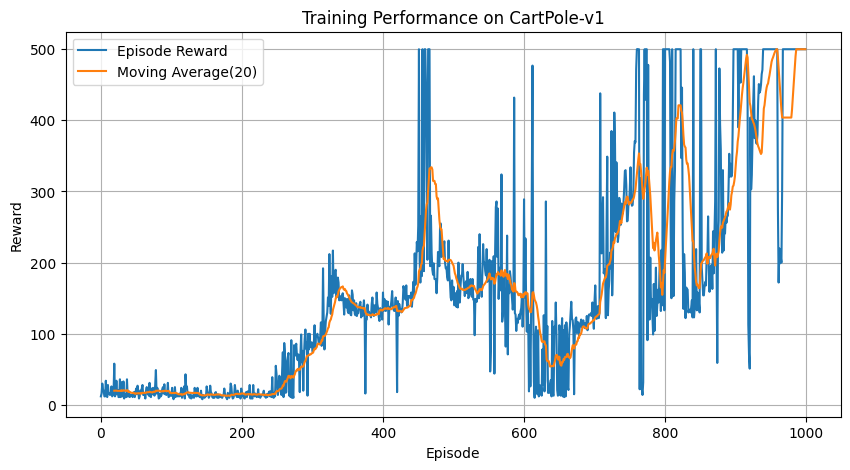

In [ ]:
window = 20
smoothed_rewards = [np.mean(all_rewards[i:i+window]) for i in range(len(all_rewards)-window+1)]

plt.figure(figsize=(10,5))
plt.plot(all_rewards, label="Episode Reward")
plt.plot(range(window-1, len(all_rewards)), smoothed_rewards, label=f"Moving Average({window})")
plt.xlabel("Episode")
plt.ylabel("Reward")
plt.title("Training Performance on CartPole-v1")
plt.legend()
plt.grid(True)
plt.show()

In [ ]:
animate_agent(env_cartpole, cartpole_agent)

/usr/local/lib/python3.10/dist-packages/gym/core.py:43: DeprecationWarning: WARN: The argument mode in render method is deprecated; use render_mode during environment initialization instead.
See here for more information: https://www.gymlibrary.ml/content/api/
  deprecation(


## Acrobot task

In [ ]:
env_acrobot = gym.make("Acrobot-v1", new_step_api=True)

In [ ]:
def a_agent_random(observation):
    return {"Action":np.random.choice([0, 1, 2])}

In [ ]:
average_episodic_return(env_acrobot, a_agent_random)

{'AverageEpisodicReturn': -968.1, 'StandardDeviation': 95.7}

In [ ]:
animate_agent(env_acrobot, a_agent_random)

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)
/usr/local/lib/python3.10/dist-packages/gym/core.py:43: DeprecationWarning: WARN: The argument mode in render method is deprecated; use render_mode during environment initialization instead.
See here for more information: https://www.gymlibrary.ml/content/api/
  deprecation(


In [ ]:
hidden_layers = [64,64]
lr = 5e-4
replay_size = 50000
acrobot_agent = Agent(env_acrobot, hidden_layers, replay_size, optim.RMSprop, lr, nn.SmoothL1Loss)
epsilon_decay = 10000
num_episodes = 1000
all_rewards = acrobot_agent.train(num_episodes, epsilon_decay)

Episode: 50, Avg Reward (last 50 eps): -383.52, Epsilon: 0.16
Episode: 100, Avg Reward (last 50 eps): -484.40, Epsilon: 0.02
Episode: 150, Avg Reward (last 50 eps): -277.52, Epsilon: 0.01
Episode: 200, Avg Reward (last 50 eps): -181.42, Epsilon: 0.01
Episode: 250, Avg Reward (last 50 eps): -112.18, Epsilon: 0.01
Episode: 300, Avg Reward (last 50 eps): -103.44, Epsilon: 0.01
Episode: 350, Avg Reward (last 50 eps): -99.84, Epsilon: 0.01
Episode: 400, Avg Reward (last 50 eps): -91.42, Epsilon: 0.01
Episode: 450, Avg Reward (last 50 eps): -84.82, Epsilon: 0.01
Episode: 500, Avg Reward (last 50 eps): -95.76, Epsilon: 0.01
Episode: 550, Avg Reward (last 50 eps): -89.14, Epsilon: 0.01
Episode: 600, Avg Reward (last 50 eps): -87.44, Epsilon: 0.01
Episode: 650, Avg Reward (last 50 eps): -87.92, Epsilon: 0.01
Episode: 700, Avg Reward (last 50 eps): -88.32, Epsilon: 0.01
Episode: 750, Avg Reward (last 50 eps): -89.56, Epsilon: 0.01
Episode: 800, Avg Reward (last 50 eps): -84.62, Epsilon: 0.01
Epi

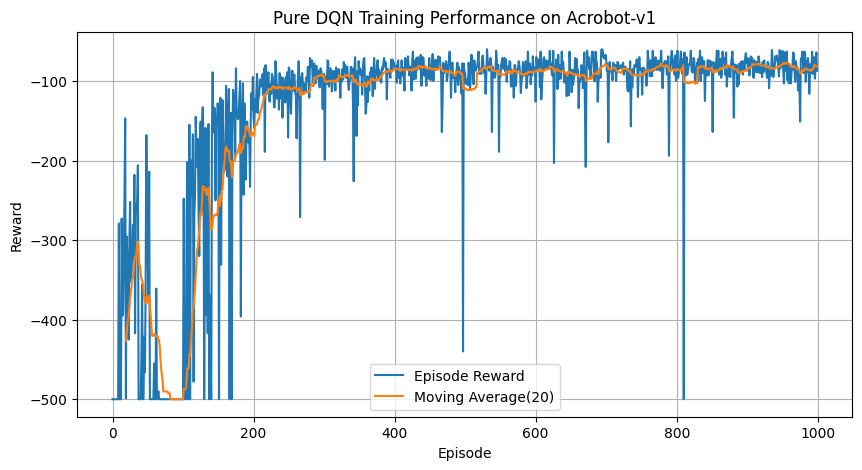

In [ ]:
window = 20
smoothed_rewards = [np.mean(all_rewards[i:i+window]) for i in range(len(all_rewards)-window+1)]

plt.figure(figsize=(10,5))
plt.plot(all_rewards, label="Episode Reward")
plt.plot(range(window-1, len(all_rewards)), smoothed_rewards, label=f"Moving Average({window})")
plt.xlabel("Episode")
plt.ylabel("Reward")
plt.title("Pure DQN Training Performance on Acrobot-v1")
plt.legend()
plt.grid(True)
plt.show()

In [ ]:
average_episodic_return(env_acrobot, acrobot_agent)

{'AverageEpisodicReturn': -88.3, 'StandardDeviation': 18.62283544468994}

In [ ]:
animate_agent(env_acrobot, acrobot_agent)

## Mountain Car Task



In [ ]:
env_mountaincar = gym.make("MountainCar-v0", new_step_api=True)

In [ ]:
def m_agent_random(observation):
    return {"Action":np.random.choice([0, 1, 2])}

In [ ]:
average_episodic_return(env_mountaincar, m_agent_random)

{'AverageEpisodicReturn': -1000.0, 'StandardDeviation': 0.0}

In [ ]:
animate_agent(env_mountaincar, m_agent_random)

/usr/local/lib/python3.10/dist-packages/gym/core.py:43: DeprecationWarning: WARN: The argument mode in render method is deprecated; use render_mode during environment initialization instead.
See here for more information: https://www.gymlibrary.ml/content/api/
  deprecation(
/usr/local/lib/python3.10/dist-packages/pygame/pkgdata.py:25: DeprecationWarning: pkg_resources is deprecated as an API. See https://setuptools.pypa.io/en/latest/pkg_resources.html
  from pkg_resources import resource_stream, resource_exists
/usr/local/lib/python3.10/dist-packages/pkg_resources/__init__.py:3154: DeprecationWarning: Deprecated call to `pkg_resources.declare_namespace('google')`.
Implementing implicit namespace packages (as specified in PEP 420) is preferred to `pkg_resources.declare_namespace`. See https://setuptools.pypa.io/en/latest/references/keywords.html#keyword-namespace-packages
  declare_namespace(pkg)
/usr/local/lib/python3.10/dist-packages/pkg_resources/__init__.py:3154: DeprecationWarning

In [ ]:
from gym.wrappers import TimeLimit

In [ ]:
m_max_steps = 1000
env_mountaincar = TimeLimit(env_mountaincar.unwrapped, max_episode_steps=m_max_steps, new_step_api=True)

In [ ]:
hidden_layers = [64,64]
lr = 5e-4
replay_size = 50000
mountaincar_agent = Agent(env_mountaincar, hidden_layers, replay_size, optim.RMSprop, lr, nn.SmoothL1Loss)
epsilon_decay = 100000
num_episodes = 1000
all_rewards = mountaincar_agent.train(num_episodes, epsilon_decay)

Episode: 50, Avg Reward: -1000.00, Epsilon: 0.61
Episode: 100, Avg Reward: -997.50, Epsilon: 0.37
Episode: 150, Avg Reward: -822.84, Epsilon: 0.25
Episode: 200, Avg Reward: -422.94, Epsilon: 0.21
Episode: 250, Avg Reward: -222.58, Epsilon: 0.18
Episode: 300, Avg Reward: -239.10, Epsilon: 0.17
Episode: 350, Avg Reward: -307.92, Epsilon: 0.14
Episode: 400, Avg Reward: -297.36, Epsilon: 0.12
Episode: 450, Avg Reward: -160.56, Epsilon: 0.12
Episode: 500, Avg Reward: -149.12, Epsilon: 0.11
Episode: 550, Avg Reward: -177.24, Epsilon: 0.10
Episode: 600, Avg Reward: -249.94, Epsilon: 0.09
Episode: 650, Avg Reward: -164.22, Epsilon: 0.08
Episode: 700, Avg Reward: -159.14, Epsilon: 0.08
Episode: 750, Avg Reward: -130.68, Epsilon: 0.07
Episode: 800, Avg Reward: -555.84, Epsilon: 0.06
Episode: 850, Avg Reward: -177.78, Epsilon: 0.05
Episode: 900, Avg Reward: -116.88, Epsilon: 0.05
Episode: 950, Avg Reward: -113.40, Epsilon: 0.05
Episode: 1000, Avg Reward: -114.14, Epsilon: 0.05


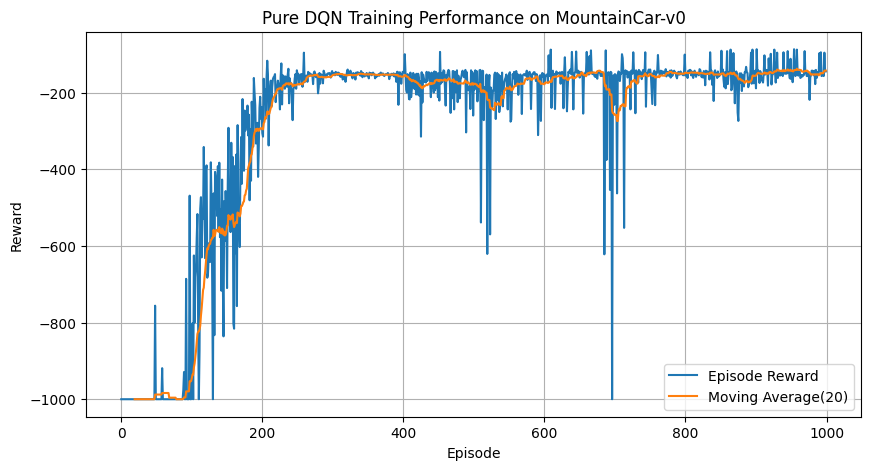

In [ ]:
window = 20
smoothed_rewards = [np.mean(all_rewards[i:i+window]) for i in range(len(all_rewards)-window+1)]

plt.figure(figsize=(10,5))
plt.plot(all_rewards, label="Episode Reward")
plt.plot(range(window-1, len(all_rewards)), smoothed_rewards, label=f"Moving Average({window})")
plt.xlabel("Episode")
plt.ylabel("Reward")
plt.title("Pure DQN Training Performance on MountainCar-v0")
plt.legend()
plt.grid(True)
plt.show()

In [ ]:
average_episodic_return(env_mountaincar, mountaincar_agent)

{'AverageEpisodicReturn': -108.4, 'StandardDeviation': 1.9595917942265424}

In [ ]:
animate_agent(env_mountaincar, mountaincar_agent)

/usr/local/lib/python3.10/dist-packages/gym/core.py:43: DeprecationWarning: WARN: The argument mode in render method is deprecated; use render_mode during environment initialization instead.
See here for more information: https://www.gymlibrary.ml/content/api/
  deprecation(


# Double DQN

In [ ]:
def draw_all_rewards(all_rewards, title, window = 20):
    smoothed_rewards = [np.mean(all_rewards[i:i+window]) for i in range(len(all_rewards)-window+1)]

    plt.figure(figsize=(10,5))
    plt.plot(all_rewards, label="Episode Reward")
    plt.plot(range(window-1, len(all_rewards)), smoothed_rewards, label=f"Moving Average({window})")
    plt.xlabel("Episode")
    plt.ylabel("Reward")
    plt.title(title)
    plt.legend()
    plt.grid(True)
    plt.show()

In [ ]:
env_cartpole = gym.make('CartPole-v1', new_step_api=True)
env_acrobot = gym.make("Acrobot-v1", new_step_api=True)
env_mountaincar = gym.make("MountainCar-v0", new_step_api=True, max_episode_steps=1000)

## cartpole task

In [ ]:
hidden_layers = [64,64]
replay_size = 50000

In [ ]:
cartpole_double_agent = Agent(env_cartpole, hidden_layers, 10000, optim.Adam, 5e-4, nn.SmoothL1Loss)
cartpole_double_dqn_rewards = cartpole_double_agent.train(1000, 5000, USE_DOUBLE_DQN=True)

Episode: 50, Avg Reward (last 50 eps): 21.96, Epsilon: 0.80
Episode: 100, Avg Reward (last 50 eps): 17.06, Epsilon: 0.68
Episode: 150, Avg Reward (last 50 eps): 14.38, Epsilon: 0.59
Episode: 200, Avg Reward (last 50 eps): 15.08, Epsilon: 0.51
Episode: 250, Avg Reward (last 50 eps): 27.96, Epsilon: 0.39
Episode: 300, Avg Reward (last 50 eps): 99.06, Epsilon: 0.15
Episode: 350, Avg Reward (last 50 eps): 103.38, Epsilon: 0.06
Episode: 400, Avg Reward (last 50 eps): 74.54, Epsilon: 0.03
Episode: 450, Avg Reward (last 50 eps): 66.64, Epsilon: 0.02
Episode: 500, Avg Reward (last 50 eps): 135.76, Epsilon: 0.01
Episode: 550, Avg Reward (last 50 eps): 214.18, Epsilon: 0.01
Episode: 600, Avg Reward (last 50 eps): 154.06, Epsilon: 0.01
Episode: 650, Avg Reward (last 50 eps): 403.12, Epsilon: 0.01
Episode: 700, Avg Reward (last 50 eps): 255.10, Epsilon: 0.01
Episode: 750, Avg Reward (last 50 eps): 128.24, Epsilon: 0.01
Episode: 800, Avg Reward (last 50 eps): 107.46, Epsilon: 0.01
Episode: 850, Avg

In [ ]:
env_cartpole.reset()
average_episodic_return(env_cartpole, cartpole_double_agent)

{'AverageEpisodicReturn': 1000.0, 'StandardDeviation': 0.0}

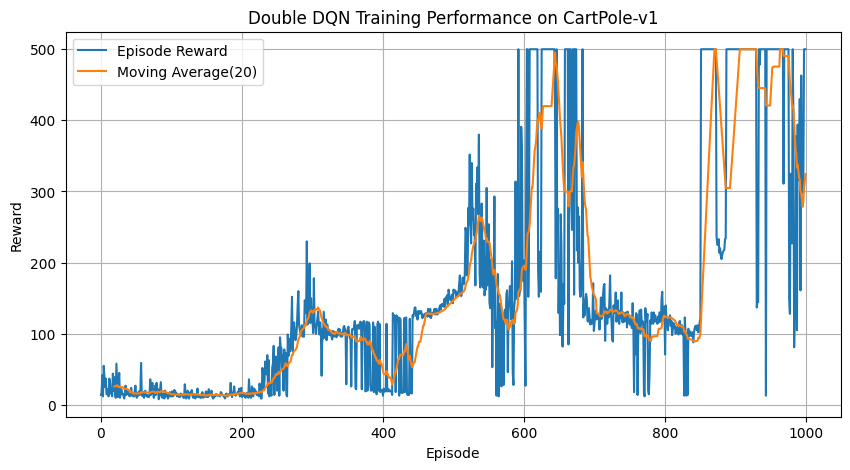

In [ ]:
draw_all_rewards(cartpole_double_dqn_rewards, "Double DQN Training Performance on CartPole-v1")

In [ ]:
animate_agent(env_cartpole, cartpole_double_agent)

## acrobot task

In [ ]:
acrobot_double_agent = Agent(env_acrobot, hidden_layers, replay_size, optim.RMSprop, 5e-4, nn.SmoothL1Loss)
acrobot_double_dqn_rewards = acrobot_double_agent.train(1000, 10000, USE_DOUBLE_DQN=True)

Episode: 50, Avg Reward (last 50 eps): -466.24, Epsilon: 0.11
Episode: 100, Avg Reward (last 50 eps): -311.30, Epsilon: 0.03
Episode: 150, Avg Reward (last 50 eps): -165.66, Epsilon: 0.02
Episode: 200, Avg Reward (last 50 eps): -222.62, Epsilon: 0.01
Episode: 250, Avg Reward (last 50 eps): -172.60, Epsilon: 0.01
Episode: 300, Avg Reward (last 50 eps): -180.74, Epsilon: 0.01
Episode: 350, Avg Reward (last 50 eps): -158.20, Epsilon: 0.01
Episode: 400, Avg Reward (last 50 eps): -131.08, Epsilon: 0.01
Episode: 450, Avg Reward (last 50 eps): -136.86, Epsilon: 0.01
Episode: 500, Avg Reward (last 50 eps): -116.26, Epsilon: 0.01
Episode: 550, Avg Reward (last 50 eps): -158.96, Epsilon: 0.01
Episode: 600, Avg Reward (last 50 eps): -121.16, Epsilon: 0.01
Episode: 650, Avg Reward (last 50 eps): -151.90, Epsilon: 0.01
Episode: 700, Avg Reward (last 50 eps): -127.98, Epsilon: 0.01
Episode: 750, Avg Reward (last 50 eps): -126.10, Epsilon: 0.01
Episode: 800, Avg Reward (last 50 eps): -92.70, Epsilon:

In [ ]:
env_acrobot.reset()
average_episodic_return(env_acrobot, acrobot_double_agent)

{'AverageEpisodicReturn': -82.7, 'StandardDeviation': 9.889893831583837}

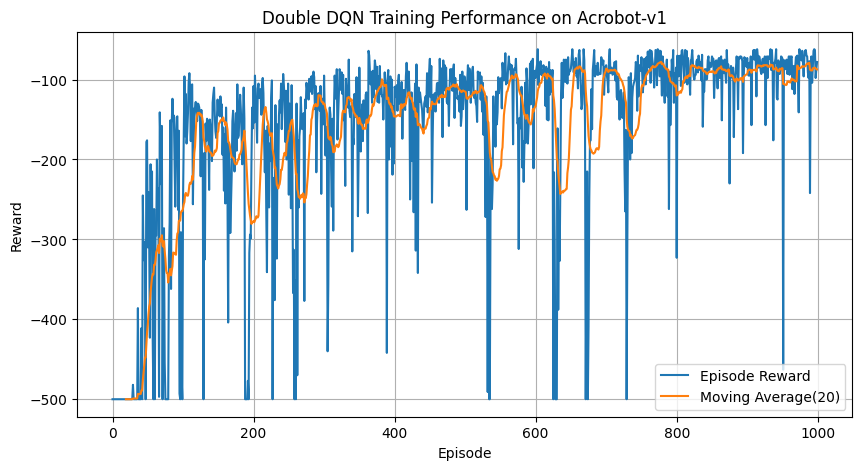

In [ ]:
draw_all_rewards(acrobot_double_dqn_rewards, "Double DQN Training Performance on Acrobot-v1")

In [ ]:
animate_agent(env_acrobot, acrobot_double_agent)

/usr/local/lib/python3.10/dist-packages/gym/core.py:43: DeprecationWarning: WARN: The argument mode in render method is deprecated; use render_mode during environment initialization instead.
See here for more information: https://www.gymlibrary.ml/content/api/
  deprecation(


## mountaincar task

In [ ]:
mountaincar_double_agent = Agent(env_mountaincar, hidden_layers, replay_size, optim.RMSprop, 5e-4, nn.SmoothL1Loss)
mountaincar_double_dqn_rewards = mountaincar_double_agent.train(1000, 100000, USE_DOUBLE_DQN=True)

Episode: 50, Avg Reward (last 50 eps): -1000.00, Epsilon: 0.61
Episode: 100, Avg Reward (last 50 eps): -1000.00, Epsilon: 0.37
Episode: 150, Avg Reward (last 50 eps): -1000.00, Epsilon: 0.23
Episode: 200, Avg Reward (last 50 eps): -1000.00, Epsilon: 0.14
Episode: 250, Avg Reward (last 50 eps): -1000.00, Epsilon: 0.09
Episode: 300, Avg Reward (last 50 eps): -1000.00, Epsilon: 0.06
Episode: 350, Avg Reward (last 50 eps): -1000.00, Epsilon: 0.04
Episode: 400, Avg Reward (last 50 eps): -1000.00, Epsilon: 0.03
Episode: 450, Avg Reward (last 50 eps): -1000.00, Epsilon: 0.02
Episode: 500, Avg Reward (last 50 eps): -1000.00, Epsilon: 0.02
Episode: 550, Avg Reward (last 50 eps): -997.02, Epsilon: 0.01
Episode: 600, Avg Reward (last 50 eps): -656.76, Epsilon: 0.01
Episode: 650, Avg Reward (last 50 eps): -271.00, Epsilon: 0.01
Episode: 700, Avg Reward (last 50 eps): -668.28, Epsilon: 0.01
Episode: 750, Avg Reward (last 50 eps): -128.94, Epsilon: 0.01
Episode: 800, Avg Reward (last 50 eps): -121.4

In [ ]:
mountaincar_double_agent = Agent(env_mountaincar, hidden_layers, replay_size, optim.RMSprop, 5e-4, nn.SmoothL1Loss)
mountaincar_double_dqn_rewards = mountaincar_double_agent.train(1000, 100000, USE_DOUBLE_DQN=True)

Episode: 50, Avg Reward (last 50 eps): -1000.00, Epsilon: 0.61
Episode: 100, Avg Reward (last 50 eps): -1000.00, Epsilon: 0.37
Episode: 150, Avg Reward (last 50 eps): -1000.00, Epsilon: 0.23
Episode: 200, Avg Reward (last 50 eps): -1000.00, Epsilon: 0.14
Episode: 250, Avg Reward (last 50 eps): -1000.00, Epsilon: 0.09
Episode: 300, Avg Reward (last 50 eps): -1000.00, Epsilon: 0.06
Episode: 350, Avg Reward (last 50 eps): -1000.00, Epsilon: 0.04
Episode: 400, Avg Reward (last 50 eps): -1000.00, Epsilon: 0.03
Episode: 450, Avg Reward (last 50 eps): -1000.00, Epsilon: 0.02
Episode: 500, Avg Reward (last 50 eps): -1000.00, Epsilon: 0.02
Episode: 550, Avg Reward (last 50 eps): -1000.00, Epsilon: 0.01
Episode: 600, Avg Reward (last 50 eps): -972.62, Epsilon: 0.01
Episode: 650, Avg Reward (last 50 eps): -778.70, Epsilon: 0.01
Episode: 700, Avg Reward (last 50 eps): -892.50, Epsilon: 0.01
Episode: 750, Avg Reward (last 50 eps): -383.20, Epsilon: 0.01
Episode: 800, Avg Reward (last 50 eps): -336.

In [ ]:
env_mountaincar.reset()
average_episodic_return(env_mountaincar, mountaincar_double_agent)

{'AverageEpisodicReturn': -128.7, 'StandardDeviation': 42.06673269936709}

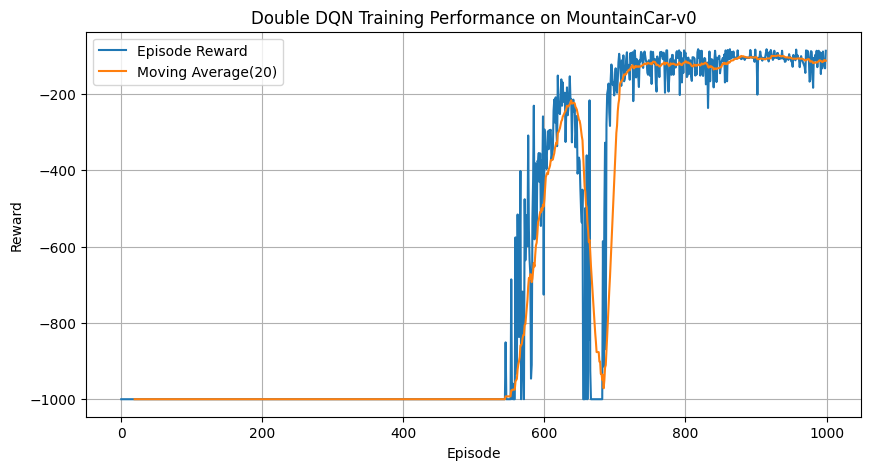

In [ ]:
draw_all_rewards(mountaincar_double_dqn_rewards, "Double DQN Training Performance on MountainCar-v0")

In [ ]:
animate_agent(env_mountaincar, mountaincar_double_agent)

/usr/local/lib/python3.10/dist-packages/gym/core.py:43: DeprecationWarning: WARN: The argument mode in render method is deprecated; use render_mode during environment initialization instead.
See here for more information: https://www.gymlibrary.ml/content/api/
  deprecation(


#Soft update Part
We use different tau and pick the best performance.

In [ ]:
hidden_layers = [64,64]
replay_size = 50000

In [ ]:
tasks = {
    "CartPole": {
        "env_name": "CartPole-v1",
        "max_steps": 500,
        "buffer_size": 10000,
        "optimizer": optim.Adam,
        "lr": 5e-4,
        "epsilon_decay": 5000,
        "epoch": 500
    },
    "Acrobot": {
        "env_name": "Acrobot-v1",
        "max_steps": 500,
        "buffer_size": 50000,
        "optimizer": optim.RMSprop,
        "lr": 5e-4,
        "epsilon_decay": 10000,
        "epoch": 1000
    },
    "MountainCar": {
        "env_name": "MountainCar-v0",
        "max_steps": 1000,
        "buffer_size": 50000,
        "optimizer": optim.RMSprop,
        "lr": 5e-4,
        "epsilon_decay": 100000,
        "epoch": 1000
    }
}


In [ ]:
taus = [0.001, 0.005, 0.01, 0.05]

In [ ]:
results = {}

In [ ]:
def test_tau(task, task_name, taus):
    print(f"\n===== Task: {task_name} =====")
    params = task[task_name]
    env = gym.make(params["env_name"], new_step_api=True,max_episode_steps=params["max_steps"])

    results[task_name] = {}

    for tau in taus:
        print(f"Training with tau = {tau}...")

        agent = Agent(
            env=env,
            hidden_layers=[64, 64],
            buffer_size=params["buffer_size"],
            optimizer=params["optimizer"],
            lr=params["lr"],
            loss_fn=nn.SmoothL1Loss,
            batch_size=64,
            gamma=0.99
        )

        agent.train(
            num_episodes=params["epoch"],
            epsilon_decay=params["epsilon_decay"],
            tau=tau,
            USE_DOUBLE_DQN=True,
            verbose=False
        )

        evaluation = average_episodic_return(
            env,
            agent,
            episodes=50,
            max_steps_per_episode=params["max_steps"]
        )

        results[task_name][tau] = evaluation
        print(f"tau = {tau} done. Avg Return: {evaluation['AverageEpisodicReturn']}, Std Dev: {evaluation['StandardDeviation']}")

    best_tau = max(results[task_name], key=lambda x: results[task_name][x]["AverageEpisodicReturn"])
    best_avg = results[task_name][best_tau]["AverageEpisodicReturn"]
    best_std = results[task_name][best_tau]["StandardDeviation"]

    print(f"\nBest tau for {task_name}: {best_tau} with Avg Return: {best_avg}, Std Dev: {best_std}")
    return {best_tau, best_avg, best_std}

In [ ]:
cartpole_tau_result = test_tau(tasks, "CartPole", taus)


===== Task: CartPole =====
Training with tau = 0.001...
tau = 0.001 done. Avg Return: 337.66, Std Dev: 49.828750736898876
Training with tau = 0.005...
tau = 0.005 done. Avg Return: 66.88, Std Dev: 4.0081916121862236
Training with tau = 0.01...
tau = 0.01 done. Avg Return: 139.94, Std Dev: 4.95745902655786
Training with tau = 0.05...
tau = 0.05 done. Avg Return: 9.46, Std Dev: 0.7799999999999999

Best tau for CartPole: 0.001 with Avg Return: 337.66, Std Dev: 49.828750736898876


In [ ]:
acrobot_tau_result = test_tau(tasks, "Acrobot", taus)


===== Task: Acrobot =====
Training with tau = 0.001...
tau = 0.001 done. Avg Return: -87.16, Std Dev: 24.184590135042605
Training with tau = 0.005...
tau = 0.005 done. Avg Return: -81.5, Std Dev: 14.780054127099806
Training with tau = 0.01...
tau = 0.01 done. Avg Return: -78.44, Std Dev: 15.342959297345477
Training with tau = 0.05...
tau = 0.05 done. Avg Return: -80.9, Std Dev: 12.769103335786738

Best tau for Acrobot: 0.01 with Avg Return: -78.44, Std Dev: 15.342959297345477


In [ ]:
mountaincar_tau_result = test_tau(tasks, "MountainCar", taus)


===== Task: MountainCar =====
Training with tau = 0.001...
tau = 0.001 done. Avg Return: -130.5, Std Dev: 43.33370512661016
Training with tau = 0.005...
tau = 0.005 done. Avg Return: -143.8, Std Dev: 9.767292357659825
Training with tau = 0.01...
tau = 0.01 done. Avg Return: -134.58, Std Dev: 22.924301516076778
Training with tau = 0.05...
tau = 0.05 done. Avg Return: -144.82, Std Dev: 7.28749614065078

Best tau for MountainCar: 0.001 with Avg Return: -130.5, Std Dev: 43.33370512661016


#Shape Reward

In [ ]:
hidden_layers = [64,64]
replay_size = 50000

In [ ]:
env_cartpole = gym.make('CartPole-v1', new_step_api=True)
env_acrobot = gym.make("Acrobot-v1", new_step_api=True)
env_mountaincar = gym.make("MountainCar-v0", new_step_api=True, max_episode_steps=1000)

## cartpole task

In [ ]:
def shaping_reward_cartpole(reward, state, next_state, action, done, info):
    pole_angle = state[2]
    next_pole_angle = next_state[2]

    shaping_reward = 0.0

    if (action == 1 and pole_angle > 0) or (action == 0 and pole_angle < 0):
        shaping_reward = 0.1

    if done:
        shaping_reward -= 1.0

    return reward + shaping_reward


In [ ]:
cartpole_shaping_agent = Agent(env_cartpole, hidden_layers, 10000, optim.Adam, 5e-4, nn.SmoothL1Loss)
cartpole_shaping_dqn_rewards = cartpole_shaping_agent.train(1000, 5000, shape_reward=shaping_reward_cartpole)

Episode: 50, Avg Reward (last 50 eps): 17.11, Epsilon: 0.84
Episode: 100, Avg Reward (last 50 eps): 16.96, Epsilon: 0.71
Episode: 150, Avg Reward (last 50 eps): 15.78, Epsilon: 0.61
Episode: 200, Avg Reward (last 50 eps): 14.18, Epsilon: 0.53
Episode: 250, Avg Reward (last 50 eps): 21.41, Epsilon: 0.43
Episode: 300, Avg Reward (last 50 eps): 57.53, Epsilon: 0.25
Episode: 350, Avg Reward (last 50 eps): 166.53, Epsilon: 0.06
Episode: 400, Avg Reward (last 50 eps): 150.97, Epsilon: 0.02
Episode: 450, Avg Reward (last 50 eps): 339.08, Epsilon: 0.01
Episode: 500, Avg Reward (last 50 eps): 226.66, Epsilon: 0.01
Episode: 550, Avg Reward (last 50 eps): 125.40, Epsilon: 0.01
Episode: 600, Avg Reward (last 50 eps): 122.00, Epsilon: 0.01
Episode: 650, Avg Reward (last 50 eps): 96.85, Epsilon: 0.01
Episode: 700, Avg Reward (last 50 eps): 38.16, Epsilon: 0.01
Episode: 750, Avg Reward (last 50 eps): 75.30, Epsilon: 0.01
Episode: 800, Avg Reward (last 50 eps): 56.80, Epsilon: 0.01
Episode: 850, Avg R

In [ ]:
env_cartpole.reset()
average_episodic_return(env_cartpole, cartpole_shaping_agent)

{'AverageEpisodicReturn': 72.5, 'StandardDeviation': 29.254914117118854}

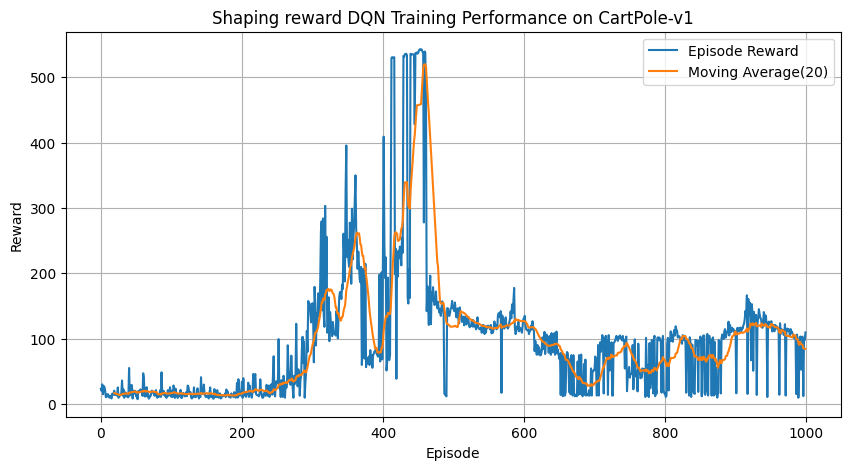

In [ ]:
draw_all_rewards(cartpole_shaping_dqn_rewards, "Shaping reward DQN Training Performance on CartPole-v1")

In [ ]:
animate_agent(env_cartpole, cartpole_shaping_agent)

/usr/local/lib/python3.10/dist-packages/gym/core.py:43: DeprecationWarning: WARN: The argument mode in render method is deprecated; use render_mode during environment initialization instead.
See here for more information: https://www.gymlibrary.ml/content/api/
  deprecation(
/usr/local/lib/python3.10/dist-packages/pygame/pkgdata.py:25: DeprecationWarning: pkg_resources is deprecated as an API. See https://setuptools.pypa.io/en/latest/pkg_resources.html
  from pkg_resources import resource_stream, resource_exists
/usr/local/lib/python3.10/dist-packages/pkg_resources/__init__.py:3154: DeprecationWarning: Deprecated call to `pkg_resources.declare_namespace('google')`.
Implementing implicit namespace packages (as specified in PEP 420) is preferred to `pkg_resources.declare_namespace`. See https://setuptools.pypa.io/en/latest/references/keywords.html#keyword-namespace-packages
  declare_namespace(pkg)
/usr/local/lib/python3.10/dist-packages/pkg_resources/__init__.py:3154: DeprecationWarning

## acrobot task

In [ ]:
def shaping_reward_acrobot(reward, state, next_state, action, done, info):
    cos_theta1, sin_theta1, cos_theta2, sin_theta2, theta1_dot, theta2_dot = state
    cos_next_theta1, sin_next_theta1, cos_next_theta2, sin_next_theta2, next_theta1_dot, next_theta2_dot = next_state

    current_height = -np.cos(np.arctan2(sin_theta1, cos_theta1)) - np.cos(np.arctan2(sin_theta1, cos_theta1) + np.arctan2(sin_theta2, cos_theta2))
    next_height = -np.cos(np.arctan2(sin_next_theta1, cos_next_theta1)) - np.cos(np.arctan2(sin_next_theta1, cos_next_theta1) + np.arctan2(sin_next_theta2, cos_next_theta2))

    height_shaping_reward = max(0, next_height - current_height)

    velocity_penalty = -0.01 * (abs(theta1_dot) + abs(theta2_dot))

    if done:
        height_shaping_reward += 1.0

    return reward + height_shaping_reward + velocity_penalty


In [ ]:
acrobot_shaping_agent = Agent(env_acrobot, hidden_layers, replay_size, optim.RMSprop, 5e-4, nn.SmoothL1Loss)
acrobot_shaping_dqn_rewards = acrobot_shaping_agent.train(1000, 10000, shape_reward = shaping_reward_acrobot)

In [ ]:
env_acrobot.reset()
average_episodic_return(env_acrobot, acrobot_shaping_agent)

{'AverageEpisodicReturn': -84.3, 'StandardDeviation': 11.180787092150535}

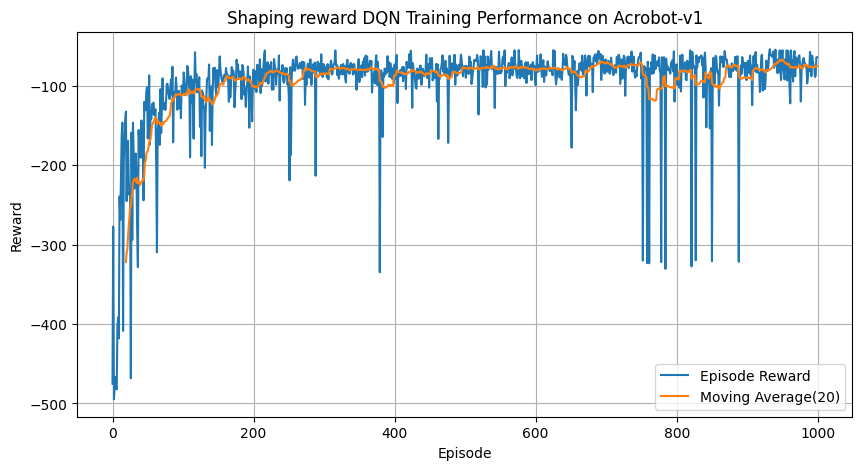

In [ ]:
draw_all_rewards(acrobot_shaping_dqn_rewards, "Shaping reward DQN Training Performance on Acrobot-v1")

In [ ]:
animate_agent(env_acrobot, acrobot_shaping_agent)

/usr/local/lib/python3.10/dist-packages/gym/core.py:43: DeprecationWarning: WARN: The argument mode in render method is deprecated; use render_mode during environment initialization instead.
See here for more information: https://www.gymlibrary.ml/content/api/
  deprecation(


## mountaincar task

In [ ]:
def shaping_reward_mountaincar(reward, state, next_state, action, done, info):
    goal_position = 0.5
    current_position = state[0]
    next_position = next_state[0]
    phi_current = abs(goal_position - current_position)
    phi_next = abs(goal_position - next_position)
    gamma = 0.99
    shaping = gamma * phi_next - phi_current
    adjusted_reward = reward + shaping

    return adjusted_reward


In [ ]:
mountaincar_shaping_agent = Agent(env_mountaincar, hidden_layers, replay_size, optim.RMSprop, 5e-4, nn.SmoothL1Loss)
mountaincar_shaping_dqn_rewards = mountaincar_shaping_agent.train(1000, 100000, shape_reward = shaping_reward_mountaincar)

Episode: 50, Avg Reward (last 50 eps): -1010.29, Epsilon: 0.61
Episode: 100, Avg Reward (last 50 eps): -984.99, Epsilon: 0.38
Episode: 150, Avg Reward (last 50 eps): -964.07, Epsilon: 0.24
Episode: 200, Avg Reward (last 50 eps): -556.19, Epsilon: 0.18
Episode: 250, Avg Reward (last 50 eps): -218.73, Epsilon: 0.17
Episode: 300, Avg Reward (last 50 eps): -154.14, Epsilon: 0.15
Episode: 350, Avg Reward (last 50 eps): -160.22, Epsilon: 0.14
Episode: 400, Avg Reward (last 50 eps): -153.41, Epsilon: 0.13
Episode: 450, Avg Reward (last 50 eps): -141.45, Epsilon: 0.13
Episode: 500, Avg Reward (last 50 eps): -147.77, Epsilon: 0.12
Episode: 550, Avg Reward (last 50 eps): -144.73, Epsilon: 0.11
Episode: 600, Avg Reward (last 50 eps): -150.25, Epsilon: 0.10
Episode: 650, Avg Reward (last 50 eps): -158.46, Epsilon: 0.10
Episode: 700, Avg Reward (last 50 eps): -146.17, Epsilon: 0.09
Episode: 750, Avg Reward (last 50 eps): -124.19, Epsilon: 0.09
Episode: 800, Avg Reward (last 50 eps): -132.74, Epsilo

In [ ]:
env_mountaincar.reset()
average_episodic_return(env_mountaincar, mountaincar_shaping_agent)

{'AverageEpisodicReturn': -109.3, 'StandardDeviation': 8.222530024268686}

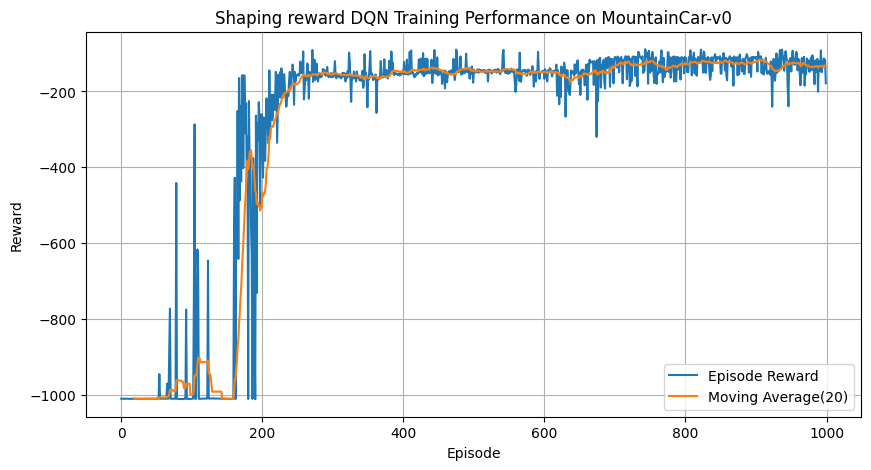

In [ ]:
draw_all_rewards(mountaincar_shaping_dqn_rewards, "Shaping reward DQN Training Performance on MountainCar-v0")

In [ ]:
animate_agent(env_mountaincar, mountaincar_shaping_agent)

/usr/local/lib/python3.10/dist-packages/gym/core.py:43: DeprecationWarning: WARN: The argument mode in render method is deprecated; use render_mode during environment initialization instead.
See here for more information: https://www.gymlibrary.ml/content/api/
  deprecation(
